# QC & preprocessing of SlideSeq data

## Libraries & setup

In [1]:
import anndata as ad
import scanpy as sc
import pandas as pd
import os

import numpy as np
from numpy.random import default_rng

import matplotlib.pyplot as plt

sc.logging.print_header()

/nfs/home/dmckellar/mambaforge/envs/sc/lib/python3.11/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/nfs/home/dmckellar/mambaforge/envs/sc/lib/python3.11/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/nfs/home/dmckellar/mambaforge/envs/sc/lib/python3.11/site-pac

scanpy==1.9.3 anndata==0.9.2 umap==0.5.3 numpy==1.24.4 scipy==1.11.1 pandas==2.0.3 scikit-learn==1.3.0 statsmodels==0.14.0 python-igraph==0.10.6 pynndescent==0.5.8


/nfs/home/dmckellar/mambaforge/envs/sc/lib/python3.11/site-packages/umap/umap_.py:660: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()


In [2]:
import gc
gc.enable()

In [3]:
os.chdir("/gpfs/commons/groups/innovation/dwm/slide_snake") # replace this path with your path...

In [4]:
import scripts.py.sc_utils as sc_utils
import scripts.py.sc_plots as sc_plots

## Settings

In [5]:
assay = "STAR"
# assay = "kb"

print(assay)

STAR


## Load data

In [6]:
samples = [
    # "T2V", "SHVN2"
    "Heart_Control", "SHVN1"
    ]
recipe = "seeker_matchLinker_total"

In [7]:
adata_dict = {}

for i, sample in enumerate(samples):
    if assay == "STAR":
        adata_dict[i] = sc.read_h5ad(
            f"out/{sample}/STARsolo/short_read/{recipe}/Solo.out/GeneFull/raw/UniqueAndMult-EM.h5ad",   
        )
    elif assay == "kb":
        adata_dict[i] = sc.read_h5ad(
            f"out/{sample}/kbpython_std/{recipe}/raw/output.h5ad"
        )

    print(f"{sample}: {adata_dict[i].shape[0]} spots x {adata_dict[i].shape[1]} genes")
    adata_dict[i].var_names_make_unique()
    print("")
    adata_dict[i].raw = adata_dict[i]

/nfs/home/dmckellar/mambaforge/envs/sc/lib/python3.11/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


Heart_Control: 52349 spots x 56941 genes

SHVN1: 51027 spots x 56941 genes



/nfs/home/dmckellar/mambaforge/envs/sc/lib/python3.11/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [8]:
# adata_dict = {}

# for i, sample in enumerate(samples):
#     if assay == "STAR":
#         adata_dict[i] = sc.read_mtx(
#             f"out/{sample}/STARsolo/short_read/{recipe}/Solo.out/GeneFull/raw/matrix.mtx",   
#         )
#     elif assay == "kb":
#         adata_dict[i] = sc.read_h5ad(
#             f"out/{sample}/kbpython_std/{recipe}/raw/output.h5ad"
#         )

#     print(f"{sample}: {adata_dict[i].shape[0]} spots x {adata_dict[i].shape[1]} genes")
#     adata_dict[i].var_names_make_unique()
#     print("")
#     adata_dict[i].raw = adata_dict[i]

In [10]:
adata_dict[1].var_names

Index(['Gm38212', 'Gm7449', 'Gm28283', 'Gm37108', 'Gm37275', 'Gm6679',
       'Gm29155', 'Gm37225', 'Gm17847', 'Gm28281',
       ...
       'ENSMUSG00000095019', 'ENSMUSG00000094915', 'ENSMUSG00000079808',
       'ENSMUSG00000095041', 'ENSMUSG00002075400', 'ENSMUSG00002074970',
       'ENSMUSG00002075729', 'ENSMUSG00002074899', 'ENSMUSG00002076890',
       'ENSMUSG00000095742'],
      dtype='object', length=56941)

In [15]:
import notebooks.utils as ec

In [11]:
sc_utils.grep_genes(adata_dict[1], "Mir")

Found 56941 features in the assay 'counts'...
Looking for 'Mir' in these features...
Output genes sorted by expression...


['Mir6236',
 'Mir99ahg',
 'Mir100hg',
 'Mir124-2hg',
 'Mir670hg',
 'Mir2137',
 'Mir6240',
 'Mir142hg',
 'Mirt1',
 'Mirg',
 'Mir217hg',
 'Mir6538',
 'Mir17hg',
 'Mir9-3hg',
 'Mir133a-1hg',
 'Mir703',
 'Mir101b',
 'Mir143',
 'Mir5100',
 'Mir1188',
 'Mir22hg',
 'Mirlet7i',
 'Mirlet7g',
 'Mir155hg',
 'Mir1969',
 'Mirlet7f-1',
 'Mirlet7b',
 'Mir124a-1hg',
 'Mirlet7f-2',
 'Mirlet7c-2',
 'Mir290b',
 'Mirlet7a-1',
 'Mir1896',
 'Mir6516',
 'Mirlet7a-2',
 'Mirlet7d',
 'Mirlet7c-1',
 'Mir682',
 'Mir133a-2',
 'Mirt2',
 'Mir16-1',
 'Mir684-1',
 'Mirlet7e',
 'Mir16-2',
 'Mir133a-1',
 'Mir5110',
 'Mir3963',
 'Mir1983',
 'Mir1932',
 'Mir542',
 'Mir6415',
 'Mir1a-1',
 'Mir5126',
 'Mir8113',
 'Mir99a',
 'Mir3068',
 'Mir1961',
 'Mir6904',
 'Mir142',
 'Mir1291',
 'Mir762',
 'Mir328',
 'Mir219c',
 'Mir378a',
 'Mir22',
 'Mir684-2',
 'Mir8114',
 'Mir208a',
 'Mir320',
 'Mir6968',
 'Mir3535',
 'Mir181a-2',
 'Mir3081',
 'Mir296',
 'Mir686',
 'Mir6937',
 'Mir205hg',
 'Mir500',
 'Mir195a',
 'Mir93',
 'Mir6935',
 

In [19]:
adata_dict[1].var_names

Index(['Gm38212', 'Gm7449', 'Gm28283', 'Gm37108', 'Gm37275', 'Gm6679',
       'Gm29155', 'Gm37225', 'Gm17847', 'Gm28281',
       ...
       'ENSMUSG00000095019', 'ENSMUSG00000094915', 'ENSMUSG00000079808',
       'ENSMUSG00000095041', 'ENSMUSG00002075400', 'ENSMUSG00002074970',
       'ENSMUSG00002075729', 'ENSMUSG00002074899', 'ENSMUSG00002076890',
       'ENSMUSG00000095742'],
      dtype='object', length=56941)

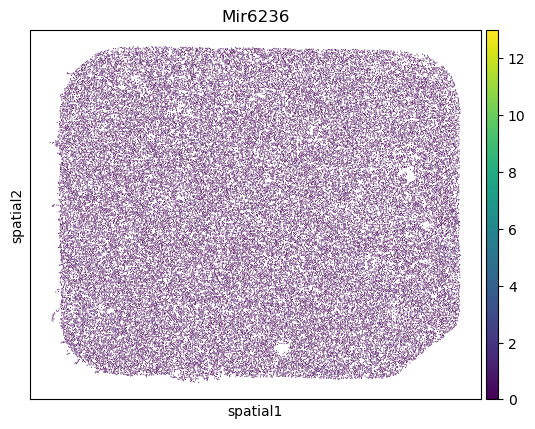

In [16]:
sc.pl.embedding(
    adata_dict[0],
    color='Mir6236',
    basis='spatial'
)

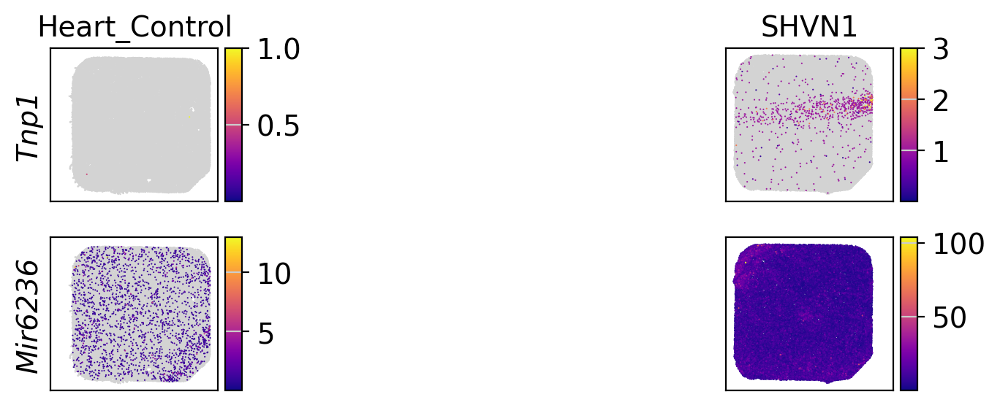

In [18]:
tmp_feat = ["Tnp1", "Mir6236"]

sc.set_figure_params(
    dpi=100,
    transparent=True
)

sc_plots.plot_grid_of_embeddings(
    adata_dict,
    # color=['clusters'],
    color=tmp_feat,
    same_scale=False,
    cmap="plasma",
    # size=5,
    vmin=0.00001,
    figsize=(12,3),
    titles=samples,
    # marker='s',
    # use_raw=True,
    basis='spatial'
)

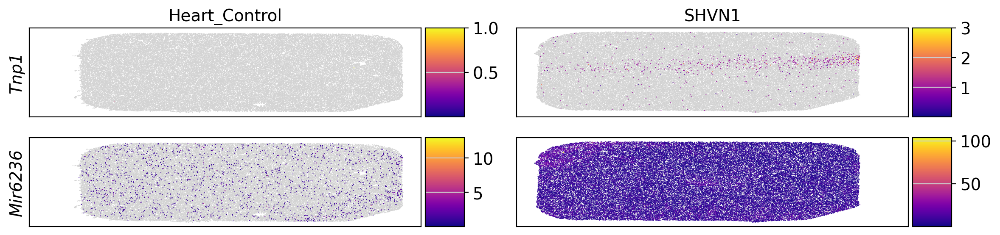

In [17]:
tmp_feat = ["Tnp1", "Mir6236"]

sc.set_figure_params(
    dpi=100,
    transparent=True
)

ec.plot_grid_of_embeddings(
    adata_dict,
    # color=['clusters'],
    color=tmp_feat,
    same_scale=False,
    cmap="plasma",
    # size=5,
    vmin=0.00001,
    figsize=(12,3),
    titles=samples,
    # marker='s',
    # use_raw=True,
    basis='spatial'
)

## QC & filtering

In [19]:
min_counts = 100

for adata in adata_dict.values():
    sc.pp.filter_cells(
        adata, 
        min_counts = min_counts
    )
    sc.pp.calculate_qc_metrics(
        adata, 
        # qc_vars=["mt", "ribo", "hb"], 
        inplace=True, 
        log1p=True
    )

## Preprocessing

In [20]:
for adata in adata_dict.values():
    sc.pp.normalize_total(
        adata, 
        target_sum=1e4
    )
    sc.pp.log1p(adata)
    # sc.pp.highly_variable_genes(
    #     adata, 
    #     flavor="seurat", 
    #     n_top_genes=1000
    # )
    sc.pp.pca(adata)
    sc.pp.neighbors(adata)
    sc.tl.leiden(
        adata, 
        key_added="leiden"
    )

In [46]:
import numpy as np
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm
from anndata import AnnData
import matplotlib.collections
# scanpy version of seuListPlot - grids of plots for a single embedding
from mpl_toolkits.axes_grid1 import make_axes_locatable


# import mpl_toolkits.axes_grid1.inset_locator as mpl_il
def plot_grid_of_embeddings(
    adata_dict,
    color,
    ncols=None,
    titles=None,
    figsize=(10, 10),
    na_color="lightgrey",
    colorbar_width=10,
    colorbar_pad=0.05,
    same_scale=False,
    filename=None,
    **kwargs,
):
    """
    Plot a grid of embeddings for multiple Anndata objects.
    Parameters:
        adata_dict (dict): Dictionary of Anndata objects. The keys represent the plot titles and the values are the corresponding Anndata objects.
        color (list): List of feature names to use for coloring the embeddings.
        ncols (int): Number of columns in the grid. If None, it is set to the number of entries in adata_dict.
        figsize (tuple): Figure size (width, height).
        same_scale (bool): If True, use the same color scale for plots showing the same feature.
        **kwargs: Additional parameters to be passed to scanpy.pl.embedding.

    """
    # param checks/sets
    if ncols is None:
        ncols = len(adata_dict)

    if titles is None:
        titles = list(adata_dict.keys())

    nrows = len(list(color))

    if len(color) >= 1:
        fig, axes = plt.subplots(
            nrows=nrows,
            ncols=ncols,
            figsize=figsize,
            sharex=True,
            sharey="row",
            # gridspec_kw={'hspace': 0}
        )
        axes = axes.flatten()
    else:
        print("Need to specify `color`")

    for i, feat in enumerate(color):
        if same_scale:
            color_min = np.inf
            color_max = -np.inf
            for j, (title, adata) in enumerate(adata_dict.items()):
                if (
                    feat in adata.obs.columns
                    and adata.obs[feat].dtype.name != "category"
                ):
                    feat_min = np.min(adata.obs[feat])
                    feat_max = np.max(adata.obs[feat])
                elif feat in adata.var_names:
                    feat_min = np.min(adata[:, feat].X)
                    feat_max = np.max(adata[:, feat].X)
                else:
                    if feat not in adata.obs.columns:
                        print(f"Feature '{feat}' not found!")
                    feat_min = float("inf")
                    feat_max = float("-inf")
                color_min = min(color_min, feat_min)
                color_max = max(color_max, feat_max)

        for j, (tmp_key, adata) in enumerate(adata_dict.items()):
            ax = axes[i * ncols + j]
            ax.set_aspect("equal")
            # vmin = color_min if same_scale else None
            vmax = color_max if same_scale else None

            if "cmap" in kwargs.keys():
                if kwargs["cmap"] is not None and type(kwargs["cmap"]) == str:
                    kwargs["cmap"] = cm.get_cmap(kwargs["cmap"])
                    kwargs["cmap"].set_under(na_color)

            # Check if a variable in adata.obs is continuous or categorical
            if feat in adata.obs.columns and adata.obs[feat].dtype.name == "category":
                # Create a divider for the existing axes instance
                # divider = make_axes_locatable(ax)

                # # Append axes to the right of ax
                # cax = divider.append_axes(
                #     "right", size=f"{colorbar_width}%", pad=colorbar_pad
                # )
                # Use the `sc.pl.embedding()` function to create the plot with the categorical variable
                sc.pl.embedding(
                    adata,
                    color=feat,
                    title=None,
                    show=False,
                    ax=ax,
                    legend_loc=None,
                    # colorbar_loc=None,
                    **kwargs,
                )
                # manually add a colorbar
                # fig.colorbar(ax.collections[0], cax=cax, orientation="vertical")
                # # Generate legend elements for the categorical variable
                # scatter = ax.collections[0]  # Assuming the first collection is the scatter plot
                # handles, labels = scatter.legend_elements(prop="colors", alpha=0.6)  # Customize appearance as needed

                # # Create a legend for the categorical variable
                # legend = ax.legend(handles, labels, title=feat, loc="upper right")  # Position and title customization
                # ax.add_artist(legend)  # Add the legend to the axis
                
                # # Manually add a legend for the categorical variable
                # categories = adata.obs[feat].cat.categories.tolist()
                # legend_handles = [
                #     plt.Line2D(
                #         [0],
                #         [0],
                #         marker="o",
                #         color="w",
                #         markerfacecolor=color,
                #         markersize=8,
                #     )
                #     for color in ax.collections[0].get_facecolor()
                # ]

                # # Create the legend
                # ax.legend(
                #     legend_handles,
                #     categories,
                #     title=feat,
                #     fontsize="small",
                #     bbox_to_anchor=(1, 0.0, (1 / colorbar_width), 1),
                #     # loc='center left', bbox_to_anchor=(1, 0.5)
                # )

            else:  # continuous variable
                # Create a divider for the existing axes instance
                divider = make_axes_locatable(ax)

                # Append axes to the right of ax
                cax = divider.append_axes(
                    "right", size=f"{colorbar_width}%", pad=colorbar_pad
                )

                sc.pl.embedding(
                    adata,
                    color=feat,
                    title=None,
                    show=False,
                    ax=ax,
                    vmax=vmax,
                    colorbar_loc=None,
                    **kwargs,
                )

                # manually add a colorbar
                fig.colorbar(ax.collections[0], cax=cax, orientation="vertical")
            # end if-statement

            # y-axis labels
            if j == 0:
                ax.set_ylabel(feat, fontsize="medium", fontstyle="italic")
            else:
                ax.set_ylabel(None)

            # x-axis labels
            ax.set_xlabel(None)
            if i == 0:
                ax.set_title(titles[j])
            else:
                ax.set_title(None)

    plt.tight_layout()

    if filename != None:
        plt.savefig(filename)

    plt.show()

/scratch/ipykernel_20850/4269443074.py:89: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  kwargs["cmap"] = cm.get_cmap(kwargs["cmap"])
/nfs/home/dmckellar/mambaforge/envs/sc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/nfs/home/dmckellar/mambaforge/envs/sc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


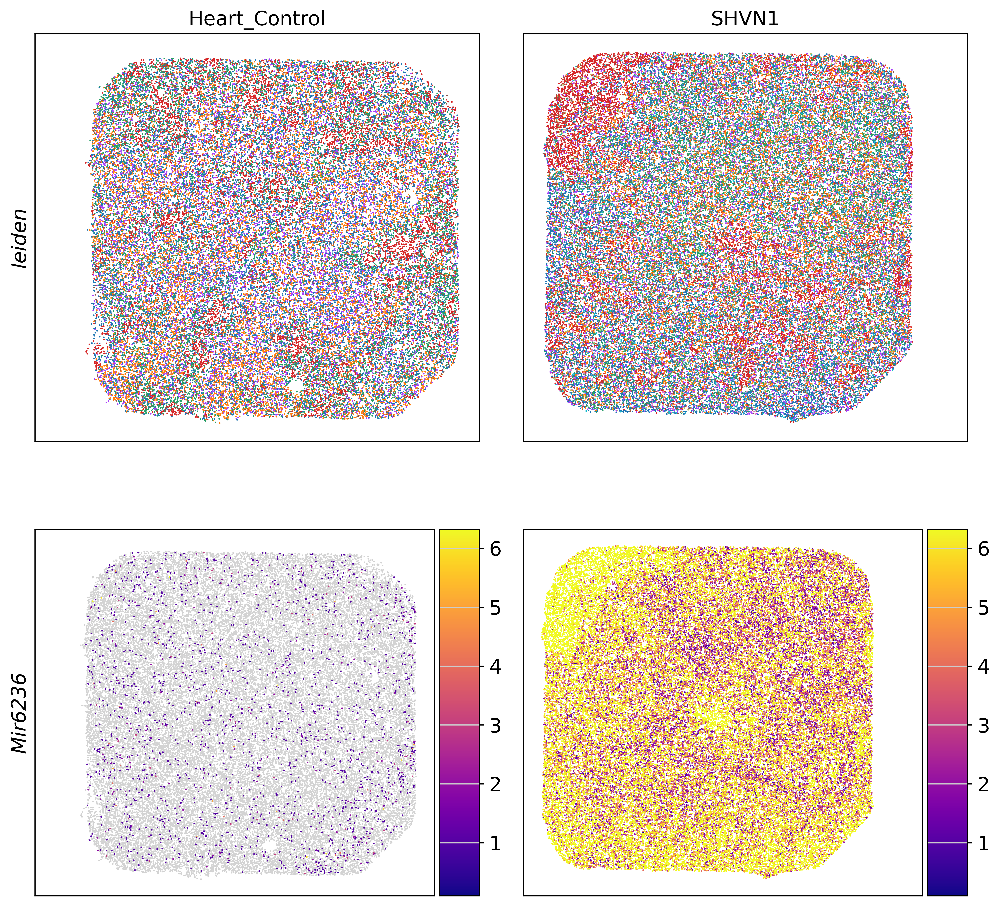

In [48]:
sc.set_figure_params(
    figsize=(10,10),
    dpi=300,
    transparent=True
)

plot_grid_of_embeddings(
    adata_dict,
    color=["leiden","Mir6236"],
    same_scale=True, 
    titles=samples,
    vmin=0.1,
    size=5,
    cmap='plasma',
    basis='spatial'
)

## Remove clusters containing empty spots

## Convert spatial coordinates to microns

In [49]:
i=0
print(f"x range: {min(adata_dict[i].obsm['spatial'][:,0])}, {max(adata_dict[i].obsm['spatial'][:,0])}")
print(f"y range: {min(adata_dict[i].obsm['spatial'][:,1])}, {max(adata_dict[i].obsm['spatial'][:,1])}")

x range: 1131.4, 5890.3
y range: 364.3, 5019.3


In [50]:
scale_factor=1/1.44  # from Curio 
print(f"Scale factor: {scale_factor}")

for i,sample in enumerate(samples):
    sc_utils.rescale_embedding(
        adata_dict[i],
        basis='spatial',
        move_to_origin=True,
        scale_factor=scale_factor
    )

Scale factor: 0.6944444444444444


## Spatial singlet filtering

Remove spots with fewer than `K` direct neighbors within `D` distance

In [51]:
for i,sample in enumerate(samples):
    print("====================")
    adata_dict[i] = sc_utils.spatial_singlet_filter(
        adata_dict[i],
        K=2,
        D=45,
        iters=4,
        inplace=False
    )

36516 total cells...
1 / 4: removed 1 cells


/gpfs/commons/groups/innovation/dwm/slide_snake/scripts/py/sc_utils.py:415: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[neighbor_key] = np.sum(basis_distances < D, axis=0)


2 / 4: removed 0 cells
   Finished after 2 iterations
42390 total cells...
1 / 4: removed 0 cells
   Finished after 1 iterations


## Plots

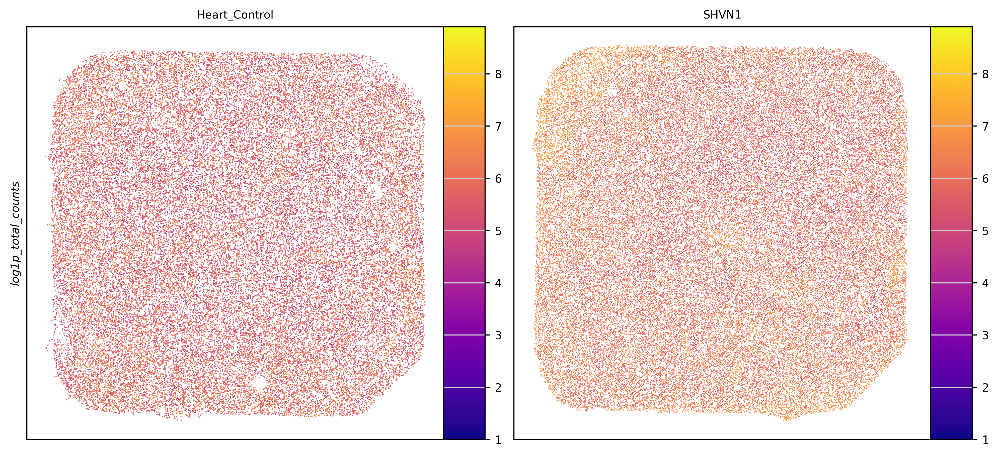

In [53]:
tmp_feat = [
    'log1p_total_counts',
    # 'n_counts_spliced_log1p',
    # 'splice_ratio',
    # 'n_counts_unspliced_log1p'
]
sc.set_figure_params(
    dpi=200,
    fontsize=8,
    transparent=True
)
sc_plots.plot_grid_of_embeddings(
    adata_dict,
    # color=['leiden'],
    color=tmp_feat,
    same_scale=True,
    cmap="plasma",
    titles=samples,
    figsize=(10,6),
    colorbar_pad=0,
    # size=5,
    vmin=1,
    hspace=0,
    # use_raw=True,
    basis='spatial'
)

In [ ]:
tmp_feat = [
    'splice_ratio',
    'pct.protein_coding', "pct.rRNA", "pct.miRNA"
]
sc.set_figure_params(
    dpi=400,
    fontsize=8,
    transparent=True
)
plot_grid_of_embeddings(
    adata_dict,
    # color=['leiden'],
    color=tmp_feat,
    same_scale=True,
    cmap="Spectral",
    titles=samples,
    figsize=(10,6),
    colorbar_pad=0,
    # size=5,
    vmin=0.01,
    hspace=0,
    # use_raw=True,
    basis='spatial'
)

In [ ]:
i=3
sc.set_figure_params(
    figsize=(3,3),
    dpi=200,
    fontsize=10,
    transparent=True
)
print(samples[i])
sc.pl.embedding(
    adata_dict[i],
    # adata_dict[i][adata_dict[i].obs['spatial_neighbors_20']<2000],
    # adata_dict[i][-adata_dict[i].obs['leiden'].isin(tmp_cl),:], 
    basis="spatial",
    # size=5**2,
    # title=samples[i],
    vmin=0.0001, vmax=1,
    # vmin=100,
    # vmax=500,
    # color="spatial_neighbors_40"
    color=["leiden","splice_ratio"]
)